# Assignment 2 Notebook 

## Oscar Chivers, 190012624

GitHub username: OscarChivers

GitHub URL: 

Assignment URL: 

Google Drive for data: 


To download the data, please click on the google drive link, and all the data needed for this lab is in there. You will need to download them to a file and then run the code. You may have to change the paths when calling the files but if you put the data in a file with the following path 'data/Assignment/...' then you will not need to do this. 

Some of the maps that are coded do not come up in the printed version. However when you run the code they will appear. Regardless, the maps that are the final maps are all pasted as images so they will be present.

# Lab 5 Challenges

## Challenge 1

It's time for you to apply everything you learned by analyzing a case study of GitHub's collaborator network data.

- **Data**: `github_users.p` (avaliable in Moodle)

> This dataset is a GitHub user collaboration network. As you already know, GitHub is a social coding site where users can collaborate on code repositories. In this network, nodes are users, and edges indicate that two users are collaborators on at least one GitHub repository.

1. Read the GitHub network dataset.
2. Describe using the basic functions of the graph's size. Explore nodes and edges. Provide how many nodes and edges are present in the network
3. Calculate the **degree centrality** of the GitHub collaboration network G. Using the .values() method of the network (e.g. G), extract the degree centrality values and convert them into a list. Then, plot a histogram to visualize the distribution of node degrees in the network.
4. Make a subset of the initial network (e.g. Gh_sub), where you include at least five nodes and their corresponding edges. Experiment with multiple nodes so you have a graph with enough edges to work on.
5. Plot the subset graph created.
6. Now calculate another relevant measure of the network -- **betweenness centrality**. Plot the betweenness centrality distribution of the subset you created. Tip: Same steps from the previous step, but use `nx.betweenness_centrality()`
7. Plot the Matrix, Arc and Circos from the subset.

Now I am going to load in the GitHub network dataset from the folder in moodle. 

1. Read the GitHub network dataset.
2. Describe using the basic functions of the graph's size. Explore nodes and edges. Provide how many nodes and edges are present in the network

In [86]:
#importing packages
import networkx as nx
import matplotlib.pyplot as plt
import warnings
import nxviz as nv

C:\Users\oscar\miniforge3\envs\ua\lib\site-packages\nxviz\__init__.py:18: UserWarning:


nxviz has a new API! Version 0.7.4 onwards, the old class-based API is being
deprecated in favour of a new API focused on advancing a grammar of network
graphics. If your plotting code depends on the old API, please consider
pinning nxviz at version 0.7.4, as the new API will break your old code.

To check out the new API, please head over to the docs at
https://ericmjl.github.io/nxviz/ to learn more. We hope you enjoy using it!

(This deprecation message will go away in version 1.0.)




In [70]:
import pickle

with open('data/github_users.p', 'rb') as f:
    Gh = pickle.load(f)
Gh

In [71]:
print(len(Gh))
print(type(Gh.nodes())) # Tells you the type of `T.nodes()`
print(list(Gh.edges(data=True))[-1]) # Read the attributes associated with the last element of the edges list. 
print(list(Gh.nodes(data=True))[0]) # Read the attributes associated with the firts element of the node list.
print(type(list(Gh.edges(data=True))[-1][2])) # Wich type; therefore, you can see what you are reading.

56519
<class 'networkx.classes.reportviews.NodeView'>
('u10898', 'u10901', {})
('u1', {'bipartite': 'users'})
<class 'dict'>


It seems as though there are no attributes for what attributes are associated with the edges, however there is an attribute associated with nodes which is 'bipartite'

In [72]:
Gh.number_of_edges()

72900

In [73]:
Gh.number_of_nodes()

56519

In this graph, there are 56,519 nodes and 72900 edges between nodes. 

In [74]:
#list(Gh.degree)
#list(Gh.adj)
#list(Gh.edges(data=True))
#list(Gh.nodes(data=True))

The above cell confirms that there are many different connections between nodes and edges, but there are no distinguishable charecteristecs to select nodes by as they all have the same attribute. Therefore I am going to select nodes and corresponding edges by nbunch rather than list comprehensions, however first I am going to work out the degree centrality. 

**Degree Centrality**

3. Calculate the **degree centrality** of the GitHub collaboration network G. Using the .values() method of the network (e.g. G), extract the degree centrality values and convert them into a list. Then, plot a histogram to visualize the distribution of node degrees in the network.


I am going to use the degree_centrality function in nx, and then make a list of the degree_centrality to values to find out how connected they are to other nodes. 

In [77]:
degree_centrality = nx.degree_centrality(Gh)
list(degree_centrality.values())

[0.00023001521639123818,
 1.76934781839414e-05,
 0.001857815209313847,
 3.53869563678828e-05,
 0.0,
 0.00253016738030362,
 0.000353869563678828,
 0.000973141300116777,
 0.0,
 3.53869563678828e-05,
 0.0005131108673343006,
 0.0,
 3.53869563678828e-05,
 0.0003361760854948866,
 0.0005838847800700662,
 0.0027778760748787996,
 0.003007891291270038,
 8.8467390919707e-05,
 0.0,
 0.0005484978237021834,
 0.000973141300116777,
 0.0,
 0.0,
 0.000353869563678828,
 1.76934781839414e-05,
 0.0,
 8.8467390919707e-05,
 0.0008138999964613044,
 0.0017516543402101986,
 0.0003007891291270038,
 0.0003715630418627694,
 0.0,
 0.0,
 0.0,
 0.0,
 3.53869563678828e-05,
 0.0003715630418627694,
 0.0013093173856116636,
 0.000353869563678828,
 1.76934781839414e-05,
 0.0004777239109664178,
 3.53869563678828e-05,
 1.76934781839414e-05,
 0.002211684772992675,
 8.8467390919707e-05,
 0.0004069499982306522,
 0.0006723521709897732,
 0.0013447043419795464,
 0.0005838847800700662,
 0.0,
 3.53869563678828e-05,
 0.00146855868926

Now I am going to plot a histogram to show the distribution of node degree connectivity in the graph.

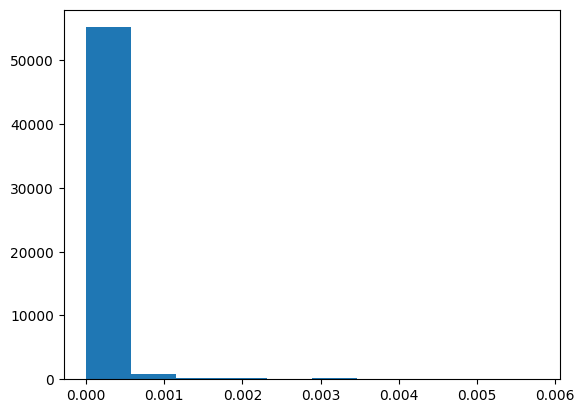

In [78]:
plt.hist(list(degree_centrality.values()))
plt.show()

The histogram above shows that most of the points are not important in terms of having a high number of degree centrality. In the case of git hub users it suggests that most users only interact with their own circle of other users and collaborate in smaller circles. However therea re a few counts where there are larger values of degree centrality, meaning that there are some GitHub accounts that many users collaborate with, these could be educational account or accounts that are the heads of large businesses with a lot of git hub users collaborating on that account.

4. Make a subset of the initial network (e.g. Gh_sub), where you include at least five nodes and their corresponding edges. Experiment with multiple nodes so you have a graph with enough edges to work on.

Now I am going to make a subset of the initial network (e.g. Gh_sub), where you include at least five nodes and their corresponding edges. To do this I am going to use the command nbunch 

In [79]:
#edges from Gh - where the numbers specify the nodes i want to subset 
edges_from_Gh=Gh.edges(["u2","u6","u53","u18","u7"])
edges_from_Gh
#I am now going to make this list into a subset graph and see how many edges there are

EdgeDataView([('u2', 'u9346'), ('u6', 'u3'), ('u6', 'u5809'), ('u6', 'u2688'), ('u6', 'u5851'), ('u6', 'u5814'), ('u6', 'u1511'), ('u6', 'u719'), ('u6', 'u1866'), ('u6', 'u3681'), ('u6', 'u7940'), ('u6', 'u1560'), ('u6', 'u712'), ('u6', 'u1230'), ('u6', 'u958'), ('u6', 'u8059'), ('u6', 'u1764'), ('u6', 'u1873'), ('u6', 'u2024'), ('u6', 'u3855'), ('u6', 'u368'), ('u6', 'u5496'), ('u6', 'u3426'), ('u6', 'u204'), ('u6', 'u6701'), ('u6', 'u1260'), ('u6', 'u2160'), ('u6', 'u409'), ('u6', 'u1879'), ('u6', 'u72'), ('u6', 'u10243'), ('u6', 'u7195'), ('u6', 'u2823'), ('u6', 'u1608'), ('u6', 'u8480'), ('u6', 'u6980'), ('u6', 'u2593'), ('u6', 'u5207'), ('u6', 'u1937'), ('u6', 'u3467'), ('u6', 'u1842'), ('u6', 'u1054'), ('u6', 'u3610'), ('u6', 'u307'), ('u6', 'u6331'), ('u6', 'u7765'), ('u6', 'u1679'), ('u6', 'u8946'), ('u6', 'u5741'), ('u6', 'u1666'), ('u6', 'u784'), ('u6', 'u1350'), ('u6', 'u816'), ('u6', 'u7256'), ('u6', 'u2094'), ('u6', 'u1890'), ('u6', 'u6984'), ('u6', 'u1748'), ('u6', 'u115'

Creating an empty graph, which I can then assign the selected nodes and corresponding edges to.

5. Plot the subset graph created.

In [80]:
Gh_sub = nx.DiGraph()
len(Gh_sub)

0

In [81]:
Gh_sub.add_edges_from(edges_from_Gh) #Adding the list from the subset of nodes.
len(Gh_sub)

225

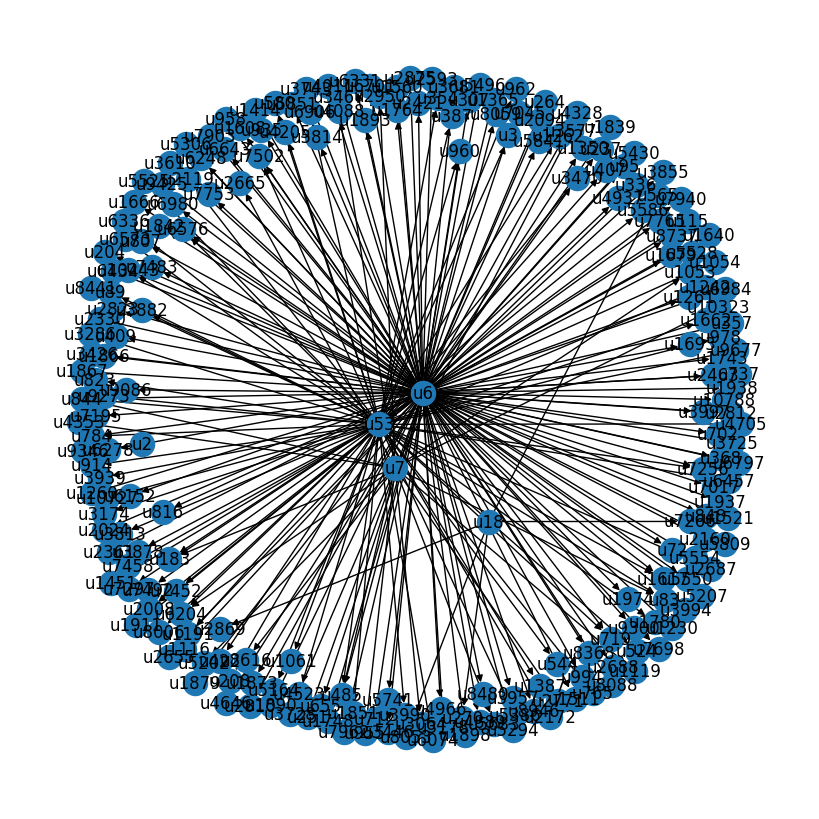

In [82]:
plt.figure(figsize=(8, 8))
nx.draw(Gh_sub, with_labels=True)
plt.show()

This graph is nice, because it shows there are some nodes which have many corresponding edges, such as u53, this suggests that u53, u7, u6 collaborate with a large number of other GitHub users, or u18, who only collaborate with a few other users, or u2, who only collaborate with one other user. 

**Betweeness centrality**

6. Now calculate another relevant measure of the network -- **betweenness centrality**. Plot the betweenness centrality distribution of the subset you created. Tip: Same steps from the previous step, but use `nx.betweenness_centrality()`
7. Plot the Matrix, Arc and Circos from the subset.

In [83]:
b_centrality = nx.betweenness_centrality(Gh_sub)
list(b_centrality.values())

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0011410954516335682,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0

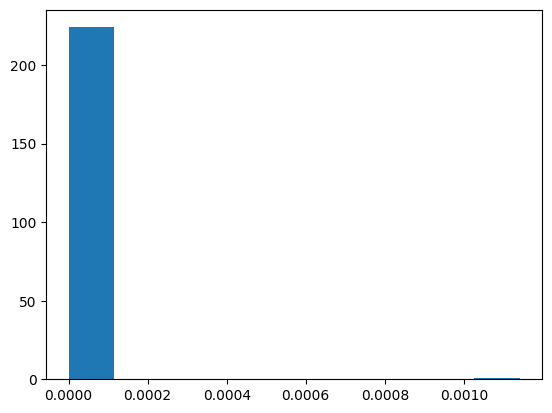

In [84]:
plt.hist(list(b_centrality.values()))
plt.show()

There is little that can be shown from this graph, this is becuause, there are a huge amount of github users and a lot of the time they collaborate with users from a small circle, therefore it was tricky to find a group of users where there was one key user whom many others collaborated. The histogram shows that there is one user who connects a couple of other users with the value of 0.0010

Plotting the Matrix, Arc and Circos from the subset.

C:\Users\oscar\miniforge3\envs\ua\lib\site-packages\nxviz\api.py:275: UserWarning:

As of nxviz 0.7, the object-oriented API is being deprecated in favour of a functional API. Please consider switching your plotting code! The object-oriented API wrappers remains in place to help you transition over. A few changes between the old and new API exist; please consult the nxviz documentation for more information. When the 1.0 release of nxviz happens, the object-oriented API will be dropped entirely.



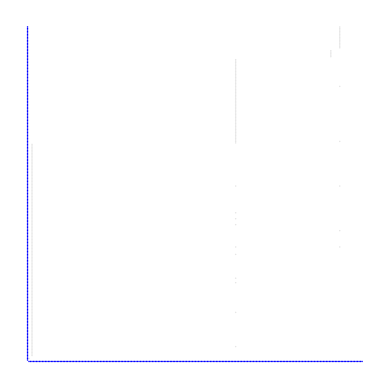

In [87]:
nv.MatrixPlot(Gh_sub)
plt.show()

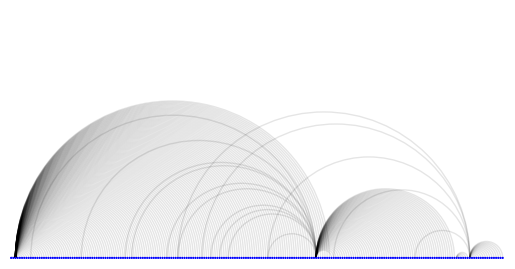

In [88]:
nv.ArcPlot(Gh_sub)
plt.show()

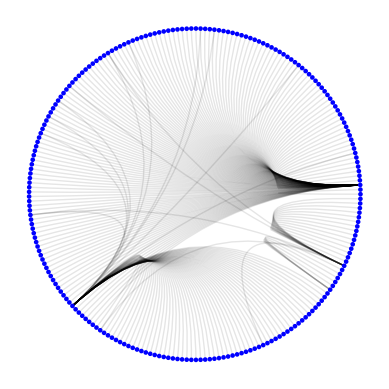

In [89]:
nv.CircosPlot(Gh_sub)
plt.show()

Thes plot shows that each node is connected to a variety of different nodes through the edges, it also shows that many of these nodes do not overlap (through the different vertical sections on the matrix plot), although it suggests that there are a some nodes which have edges between 2 or more other nodes (shown in both the arc plot and the circos plot with some edges going back to a node that has already been in the plot). 

## Challenge 2

This challenge is about OSMnx. You will explore and analyze a city's street network using the OSMnx Python library.

1. Use OSMnx to download the street network of a city of your choice. You can specify the city name, BBox or a Dict.
2. Calculate basic statistics for the street network, such as the number of nodes, edges, average node degree, etc.
3. Use OSMnx to plot the street network. Customize the plot to make it visually appealing, including node size, edge color. See the potential options here: https://osmnx.readthedocs.io/en/stable/user-reference.html#module-osmnx.plot
4. Utilize the routing capabilities of OSMnx to find the shortest path between two points in the street network. Plot the route on top of the street network.
5. Calculate the centrality measures (e.g., degree centrality and betweenness_centrality) for nodes in the street network.
6. Create the figure-groud from the selected city
7. Create interactive maps to plot nodes, edges, nodes+edges and one of the centrality measures.
8. Export the street network to a GeoPackage (.gpkg) file. Ensure that the exported file contains both node and edge attributes. Demonstrate that the new GeoPackage can be used and read in Python using any of the libraries we have seen in the class to create a simple and interactive map.
9. Finally, use OSMnx to extract other urban elements (e.g., buildings, parks) and plot them.

# Lab 6 Challenges

## Challenge 1

In this challenge, you will replicate the process of creating a geodemographic classification using the k-means clustering algorithm. Please select any city in the UK except London, Liverpool, or Glasgow. The main goal is to generate a meaningful and informative classification that captures the diversity of areas in your dataset using the census data ( For England, you can try to use the 2021 or 2011 census, and for Scotland, you need to use the 2011 census data) 

1. Define the main goal for the geodemographic classification (marketing, retail and service planning). 
2. Look for census data from the selected city for which you would like to generate the geodemographic classification.
3. The census data at the Output Area OA level. Select multiple topics of at least four topics (socio-demographics, economics, health, and so on). Describe your topic selection accordingly based on the goal of your geodemographic classification. For example, if your geodemographics are related to marketing, Economic variables might be the appropriate selection. 
4. Identify the variables that will be crucial for effectively segmenting neighbourhoods. Evaluate how this choice may impact the classification results, including a DEA analysis.
5. Prepare, adjust or clean the dataset addressing any missing values or outliers that could distort the clustering results.
6. Include standardisation between areas and variables. Make an appropriate analysis and adjust the variable selection accordingly for any multicollinearity.
7. Utilize the k-means clustering algorithm to create a classification based on the selected variables.
8. Define the optimum number of clusters (i.e., using the Elblow method). Experiment with different values of k.
9. Evaluate your cluster groups (e.g., using PCA) and interpret your cluster centres. Describe your results and repeat the process to adjust the variable selection and cluster groups to provide more meaningful results for your geodemographic goal. Interpret the characteristics of each cluster. What demographic patterns or similarities are prevalent within each group?
10. Map the final cluster groups
11. Finish the analysis by naming the final clusters and plotting a final map that includes the census values and the provided names.
12. Finally, acknowledge the subjective nature of classification and make analytical decisions to produce an optimum classification for your specific purpose. Reflect on the challenges and insights gained during the classification process. Ensure you document your analytical decisions and the rationale behind any important decision. Once your geodemographics are constructed, describe the potential use cases for the geodemographic classification you have built based on your initial goal.

1. Define the main goal for the geodemographic classification (marketing, retail and service planning).
2. Look for census data from the selected city for which you would like to generate the geodemographic classification.

Geodemographic classification is a method of grouping geogrpahical neighbourhoods that are based on similar characteristics. They can be used for marketing so that different companies may know more about where their proudcts should be placed. Such as young adults who may be thinkning about having children, geodemographic classification can show that there are more people living in these areas therefore marketing and retail should be placed more in these areas. Or if there are areas that have more old people, who tend to require more healthcare services, geodemographic classification can help show areas that may be of importance 

In my geodemographic classification, I will try and how socio-deomgraphic and economic factors are shown in different classifications in Edinburgh. It will focus on the different education, economic and housing characteristics are classified in Edinburgh. This will be useful as it may help with service allocation, such as providing increasing funcing to schools or hospitals in a certain area. It may also help to determine demographics of certain areas like the life stages of people and this will help with marketing products to certaini demographies - such as those who may be looking to purchase a house, or even those who are looking to have children. 

3. The census data at the Output Area OA level. Select multiple topics of at least four topics (socio-demographics, economics, health, and so on). Describe your topic selection accordingly based on the goal of your geodemographic classification. For example, if your geodemographics are related to marketing, Economic variables might be the appropriate selection. 

These are the following topics that I think will be useful for the my geodemographic classification. 

* KS102SC - Age structure - Demographics 
* QS104SC - Sex - Demographics 
* QS501SC - Highest level of qualification - Education 
* QS302SC - General Health - Health 
* QS301SCb - Provision of unpaid care - Health/Economic
* KS601SC - Economic activity - Economic 
* KS604SCa - Hours worked - Economic
* QS703SC - Distance travelled to work - Economic
* QS405SC - Tenure - Housing
* QS118SC - Families with dependent children - Housing

The OA census attributes were downloaded through the following link [OA Census Data](https://www.scotlandscensus.gov.uk/documents/2011-census-table-data-output-area-2011/). The boundary for the city of Edinburgh was downloaded through the following link [OA Boundaries](https://borders.ukdataservice.ac.uk/bds.html)

I am now going to load the data (csv's) into the notebook and merge them together. 

To do this I need to make a directory for where all the CSVs can be found, then make an empty pandas dataframe. Then join the csvs and make a dataframe containig all of them. 

I had to do some editing of the CSVs before they could be merged, some of them had explanations of what data was in the CSV and this had to be deleted as it meant that they could not be merged. 

In [1]:
import pandas as pd
import os

csv_directory = "data/census_raw/"

# We need a list of all CSV files in the folder
csv_files = [file for file in os.listdir(csv_directory) if file.endswith(".csv")]

# An empty DataFrame to store the merged dat
merged_data = pd.DataFrame()

# Loop through each CSV file
for csv_file in csv_files:
    csv_path = os.path.join(csv_directory, csv_file) # We create a consistent path
    df_csv = pd.read_csv(csv_path, low_memory=False) #read each file
    # Concatenate/Merge all columns, there is a pitfall here, you will get a duplicate oa_code from all csv files.
    merged_data = pd.concat([merged_data, df_csv], axis=1)

# Save the merged dataset. You might want to do some pre-processing.
#merged_data.to_csv("data/merged_census_data.csv", index=False)
# eventually you can avoid this to define the dtype on import method.

I am now going to clip the merged census data to the shapefile of City of Edinburgh, this is so that the dataset is more managable, I am going to save the merged data to a file so that I do not need to do these two lines of code above and below each time that i run the code. However if this is the first time that you are running the code, then you will need to run these cells!

In [2]:
import pandas as pd
import geopandas as gpd

shp_path = "data/scotland_oa_2011.shp"
gdf = gpd.read_file(shp_path)

csv_path = "data/merged_census_data.csv"
csv_data = pd.read_csv(csv_path, low_memory=False)

# Merge the GeoDataFrame with the DataFrame based on the oa_code
merged_data = gdf.merge(csv_data, left_on='code', right_on='oa_code', how='left')

I am now going to inspect the whole of the merged data and then decide which variables to continue my analysis with, so that I can show how there are different categories in my geodemographic classification. 

In [4]:
list(merged_data.columns)

['objectid',
 'code',
 'hhcount',
 'popcount',
 'council',
 'sqkm',
 'hect',
 'masterpc',
 'easting',
 'northing',
 'shape_1_le',
 'shape_1_ar',
 'label',
 'name',
 'geometry',
 'oa_code',
 'All people',
 '0 to 4',
 '5 to 7',
 '8 to 9',
 '10 to 14',
 '15',
 '16 to 17',
 '18 to 19',
 '20 to 24',
 '25 to 29',
 '30 to 44',
 '45 to 59',
 '60 to 64',
 '65 to 74',
 '75 to 84',
 '85 to 89',
 '90 and over',
 'Mean age',
 'Median age',
 'oa_code.1',
 'All people aged 16 to 74',
 'Economically active: Employee: Part-time',
 'Economically active: Employee: Full-time',
 'Economically active: Self-employed',
 'Economically active: Unemployed',
 'Economically active: Full-time student',
 'Economically inactive: Retired',
 'Economically inactive: Student',
 'Economically inactive: Looking after home or family',
 'Economically inactive: Long-term sick or disabled',
 'Economically inactive: Other',
 'Unemployed people aged 16 to 74: Aged 16 to 24',
 'Unemployed people aged 16 to 74: Aged 50 to 74',
 'U

In [5]:
merged_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4322 entries, 0 to 4321
Columns: 132 entries, objectid to Other (2)
dtypes: float64(6), geometry(1), int64(3), object(122)
memory usage: 4.4+ MB


In [6]:
merged_data.shape

(4322, 132)

In [7]:
merged_data.head()

,objectid,code,hhcount,popcount,council,sqkm,hect,masterpc,easting,northing,...,Work mainly at or from home,Less than 2km,2km to less than 5km,5km to less than 10km,10km to less than 20km,20km to less than 30km,30km to less than 40km,40km to less than 60km,60km and over,Other (2)
0,7324,S00106438,65,151,S12000036,0.037986,3.798556,EH28 8SU,311939,672588,...,8,14,5,24,24,-,1,-,-,7
1,16098,S00105168,56,85,S12000036,0.002870,0.286985,EH11 1JH,324213,672474,...,4,12,18,6,2,4,-,-,2,2
2,18811,S00104758,32,66,S12000036,0.001676,0.167614,EH9 1PE,325957,672335,...,2,7,10,3,2,2,2,-,-,1
3,15991,S00106865,48,133,S12000036,10.147070,1014.707020,EH14 7JD,314377,665609,...,16,2,4,14,18,-,-,2,2,9
4,17596,S00106064,50,100,S12000036,0.010604,1.060360,EH15 2NA,331564,673116,...,4,-,2,13,3,-,1,-,2,2


I need to select some columns from the many different variables that I have. Therefore I am going to look at some variables in more depth to see their distribution and if there is anything interesting that is worth putting in my geodemographics analysis

4. Identify the variables that will be crucial for effectively segmenting neighbourhoods. Evaluate how this choice may impact the classification results, including a DEA analysis.

In [8]:
# summary statistics
merged_data['Work mainly at or from home'].describe()

count     4322
unique      27
top          3
freq       574
Name: Work mainly at or from home, dtype: object

In [9]:
merged_data['Economically active: Employee: Full-time'].describe()

count     4322
unique      92
top         33
freq       141
Name: Economically active: Employee: Full-time, dtype: object

In [10]:
merged_data['One dependent child in family aged 0 to 4'].describe()

count     4322
unique      18
top          1
freq      1026
Name: One dependent child in family aged 0 to 4, dtype: object

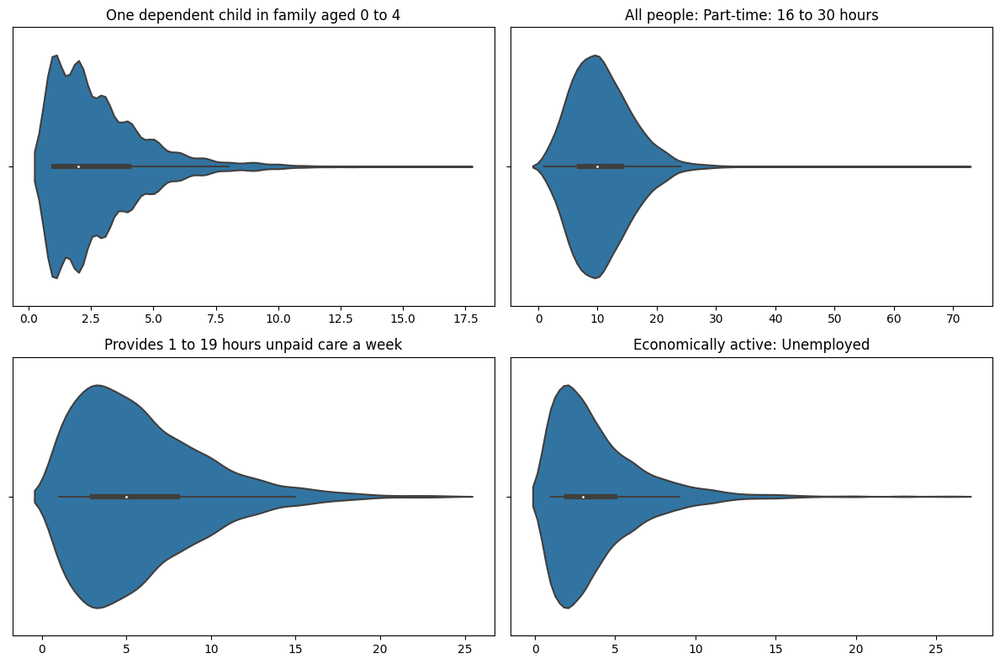

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt

attributes_to_plot = ['One dependent child in family aged 0 to 4',
                      'All people: Part-time: 16 to 30 hours',
                      'Provides 1 to 19 hours unpaid care a week',
                      'Economically active: Unemployed']

plt.figure(figsize=(12, 8))

for i, attribute in enumerate(attributes_to_plot, 1):
    plt.subplot(2, 2, i)
    merged_data[attribute] = pd.to_numeric(merged_data[attribute], errors='coerce')
    sns.violinplot(x=merged_data[attribute])
    plt.title(attribute)
    plt.xlabel('')
    plt.ylabel('')

plt.tight_layout()
plt.show()

C:\Users\oscar\miniforge3\envs\ua\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\oscar\miniforge3\envs\ua\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\oscar\miniforge3\envs\ua\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\oscar\miniforge3\envs\ua\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Conver

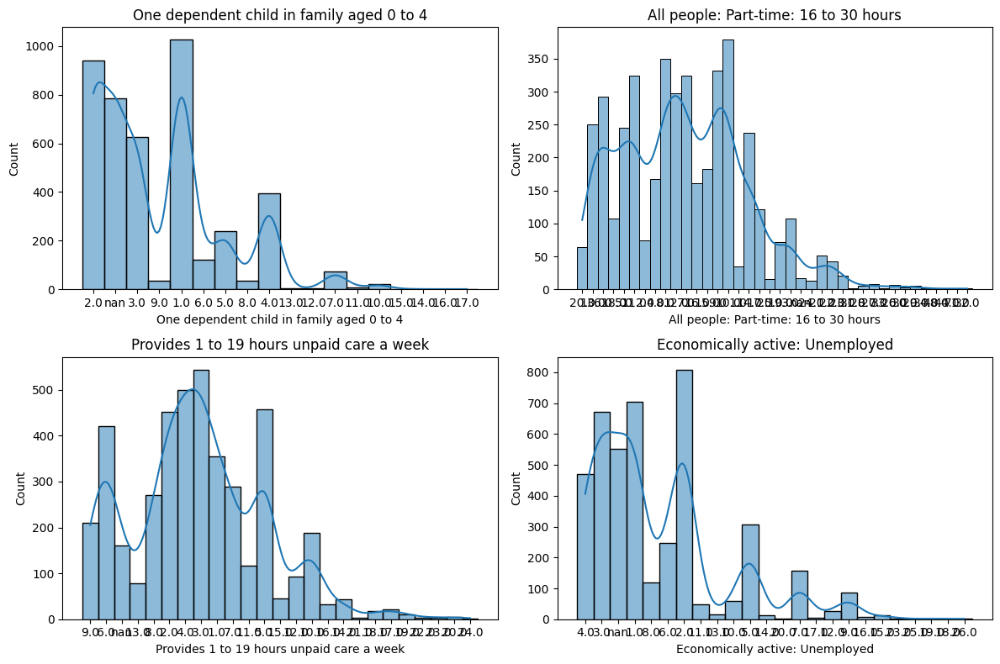

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

attributes_to_plot = ['One dependent child in family aged 0 to 4',
                      'All people: Part-time: 16 to 30 hours',
                      'Provides 1 to 19 hours unpaid care a week',
                      'Economically active: Unemployed']

plt.figure(figsize=(12, 8))

for i, attribute in enumerate(attributes_to_plot, 1):
    plt.subplot(2, 2, i)
    sns.histplot(merged_data[attribute].astype(str), kde=True)
    plt.title(attribute)

plt.tight_layout()
plt.show()

I am going to select variables that are related to the different aspects of my census data. Various variables will be used that relate to the following aspects of the census data: 

* Age range
* Employment
* Sex
* Dependent children in the family
* Unpaid care provided
* General Health
* Housing status 
* Education level
* Distance travelled for work

I hope that these variables selected will show the different classifications will show if are areas where certain demographies have to travel further for work, if the economics and education are different and if there are different levels of healthcare, in terms of their own health and those who they have to give care to. It will also show if there are various housing categories in Edinburgh. 

I have selected the data and will have to check for association between the variables. But there is also bias in the results of the geodemographic classification. This is because I have selected the 19 variables I want to analyse, therefore the results may be skewed towards showing classifications regarding the health, housing and economics of the City of Edinburgh. Whereas it must be noted that this is not a perfect classification and there are many other geodemographic categorisations possible. 

The next code will subset the 19 variables I have selected, and it will make them into a percentage, to standardise the, between ateas. This is to account for larger OAs where there will be higher counts of things. 

It is important to note that I have used different denominators depeneding on what teh variable is. I  know which demoninator is through looking at the data list of merged_data. The denominator is under each oa_code. It is important that they go with the asssociated data. 

5. Prepare, adjust or clean the dataset addressing any missing values or outliers that could distort the clustering results.
6. Include standardisation between areas and variables. Make an appropriate analysis and adjust the variable selection accordingly for any multicollinearity.

In [13]:
def calculate_percentages(dataframe, total_columns, value_columns):

    result_df = pd.DataFrame()

    for total_col, value_col in zip(total_columns, value_columns):
        percentage_col_name = f"{value_col}_percentage"

        if total_col not in dataframe.columns:
            raise ValueError(f"Total column '{total_col}' not found in the DataFrame.")
        # The data have several empty values, so you need to process them, forcing them to be a numeric or NaN value
        dataframe[value_col] = pd.to_numeric(dataframe[value_col], errors='coerce')
        dataframe[total_col] = pd.to_numeric(dataframe[total_col], errors='coerce')
        
        result_df[percentage_col_name] = (dataframe[value_col] / dataframe[total_col]) * 100

    return result_df

# List of the corresponding totals.
total_cols = ['All people','All people',
              'All people aged 16 to 74','All people aged 16 to 74', 'All people aged 16 to 74',
              'All people aged 16 to 74 in employment',
              'All people.1',
              'All families in households','All families in households',
              'All people.2','All people.2',
              'All people.3','All people.3',
              'All households','All households','All households',
              'All people aged 16 and over',
              'All people aged 16 to 74 in employment.1','All people aged 16 to 74 in employment.1' ]
# List of the corresponding values. 
value_cols = ['30 to 44',
              '65 to 74',
              'Economically active: Employee: Full-time',
              'Economically active: Unemployed',
              'Economically active: Full-time student',
              'All people: Part-time: 16 to 30 hours',
              'Males',
              'No dependent children in family',
              'One dependent child in family aged 0 to 4',
              'Provides no unpaid care',
              'Provides 1 to 19 hours unpaid care a week',
              'Good health',
              'Bad health',
              'Owned',
              'Social rented',
              'Private rented',
              'All people aged 16 and over: Level 4 and above',
              'Work mainly at or from home', 
              '5km to less than 10km']

# Later we migth need to rename those columns., for now is ok...
result_dataframe = calculate_percentages(merged_data, total_cols, value_cols)

# but what's important is you are aware of the correct total as dominator, census data can be very tricky

In [14]:
result_dataframe.head()

,30 to 44_percentage,65 to 74_percentage,Economically active: Employee: Full-time_percentage,Economically active: Unemployed_percentage,Economically active: Full-time student_percentage,All people: Part-time: 16 to 30 hours_percentage,Males_percentage,No dependent children in family_percentage,One dependent child in family aged 0 to 4_percentage,Provides no unpaid care_percentage,Provides 1 to 19 hours unpaid care a week_percentage,Good health_percentage,Bad health_percentage,Owned_percentage,Social rented_percentage,Private rented_percentage,All people aged 16 and over: Level 4 and above_percentage,Work mainly at or from home_percentage,5km to less than 10km_percentage
0,13.245033,8.609272,48.695652,3.478261,NaN,24.096386,52.317881,65.957447,4.255319,87.417219,5.960265,25.827815,5.960265,72.307692,20.000000,6.153846,16.535433,9.638554,28.915663
1,24.705882,1.176471,45.000000,3.750000,7.500000,23.214286,45.882353,94.736842,NaN,89.411765,7.058824,21.176471,4.705882,44.642857,7.142857,46.428571,60.000000,8.000000,12.000000
2,22.727273,1.515152,41.269841,4.761905,15.873016,15.789474,51.515152,80.000000,20.000000,100.000000,NaN,25.757576,NaN,40.625000,NaN,50.000000,57.812500,6.896552,10.344828
3,20.300752,9.774436,35.294118,NaN,6.862745,25.000000,54.887218,52.500000,7.500000,87.218045,9.774436,15.037594,1.503759,52.083333,2.083333,29.166667,40.000000,23.880597,20.895522
4,16.000000,17.000000,22.727273,4.545455,4.545455,16.666667,45.000000,54.545455,NaN,90.000000,8.000000,18.000000,5.000000,30.000000,66.000000,4.000000,44.444444,14.814815,48.148148


In [15]:
result_dataframe.shape

(4322, 19)

In [16]:
# Concatenate the resulting tables.
concatenated_df = pd.concat([merged_data, result_dataframe], axis=1, ignore_index=False)
concatenated_df.head()

,objectid,code,hhcount,popcount,council,sqkm,hect,masterpc,easting,northing,...,Provides no unpaid care_percentage,Provides 1 to 19 hours unpaid care a week_percentage,Good health_percentage,Bad health_percentage,Owned_percentage,Social rented_percentage,Private rented_percentage,All people aged 16 and over: Level 4 and above_percentage,Work mainly at or from home_percentage,5km to less than 10km_percentage
0,7324,S00106438,65,151,S12000036,0.037986,3.798556,EH28 8SU,311939,672588,...,87.417219,5.960265,25.827815,5.960265,72.307692,20.000000,6.153846,16.535433,9.638554,28.915663
1,16098,S00105168,56,85,S12000036,0.002870,0.286985,EH11 1JH,324213,672474,...,89.411765,7.058824,21.176471,4.705882,44.642857,7.142857,46.428571,60.000000,8.000000,12.000000
2,18811,S00104758,32,66,S12000036,0.001676,0.167614,EH9 1PE,325957,672335,...,100.000000,NaN,25.757576,NaN,40.625000,NaN,50.000000,57.812500,6.896552,10.344828
3,15991,S00106865,48,133,S12000036,10.147070,1014.707020,EH14 7JD,314377,665609,...,87.218045,9.774436,15.037594,1.503759,52.083333,2.083333,29.166667,40.000000,23.880597,20.895522
4,17596,S00106064,50,100,S12000036,0.010604,1.060360,EH15 2NA,331564,673116,...,90.000000,8.000000,18.000000,5.000000,30.000000,66.000000,4.000000,44.444444,14.814815,48.148148


In [17]:
list(concatenated_df.columns)

['objectid',
 'code',
 'hhcount',
 'popcount',
 'council',
 'sqkm',
 'hect',
 'masterpc',
 'easting',
 'northing',
 'shape_1_le',
 'shape_1_ar',
 'label',
 'name',
 'geometry',
 'oa_code',
 'All people',
 '0 to 4',
 '5 to 7',
 '8 to 9',
 '10 to 14',
 '15',
 '16 to 17',
 '18 to 19',
 '20 to 24',
 '25 to 29',
 '30 to 44',
 '45 to 59',
 '60 to 64',
 '65 to 74',
 '75 to 84',
 '85 to 89',
 '90 and over',
 'Mean age',
 'Median age',
 'oa_code.1',
 'All people aged 16 to 74',
 'Economically active: Employee: Part-time',
 'Economically active: Employee: Full-time',
 'Economically active: Self-employed',
 'Economically active: Unemployed',
 'Economically active: Full-time student',
 'Economically inactive: Retired',
 'Economically inactive: Student',
 'Economically inactive: Looking after home or family',
 'Economically inactive: Long-term sick or disabled',
 'Economically inactive: Other',
 'Unemployed people aged 16 to 74: Aged 16 to 24',
 'Unemployed people aged 16 to 74: Aged 50 to 74',
 'U

I now have a dataframe which has the columns with percentages - which is what I want for the analysis, and I have combined it with the original dataframe, which has the geometries, which I need for the geodemographic analysis. So I am now going to subset the data which is in a percentage and also subset the geometries, code, popcount and any other variables that may be important. 

In [18]:
keep_cols= [
    'code',
    'popcount',
    'hhcount',
    'geometry',
    '30 to 44_percentage',
    '65 to 74_percentage', 
    'Economically active: Employee: Full-time_percentage', 
    'Economically active: Unemployed_percentage', 
    'Economically active: Full-time student_percentage',
    'All people: Part-time: 16 to 30 hours_percentage',
    'Males_percentage',
    'No dependent children in family_percentage',
    'One dependent child in family aged 0 to 4_percentage',
    'Provides no unpaid care_percentage',
    'Provides 1 to 19 hours unpaid care a week_percentage',
    'Good health_percentage',
    'Bad health_percentage',
    'Owned_percentage',
    'Social rented_percentage',
    'Private rented_percentage',
    'All people aged 16 and over: Level 4 and above_percentage',
    'Work mainly at or from home_percentage',
    '5km to less than 10km_percentage']

edin_census_data = concatenated_df[keep_cols]

In [19]:
edin_census_data.head()

,code,popcount,hhcount,geometry,30 to 44_percentage,65 to 74_percentage,Economically active: Employee: Full-time_percentage,Economically active: Unemployed_percentage,Economically active: Full-time student_percentage,All people: Part-time: 16 to 30 hours_percentage,...,Provides no unpaid care_percentage,Provides 1 to 19 hours unpaid care a week_percentage,Good health_percentage,Bad health_percentage,Owned_percentage,Social rented_percentage,Private rented_percentage,All people aged 16 and over: Level 4 and above_percentage,Work mainly at or from home_percentage,5km to less than 10km_percentage
0,S00106438,151,65,"POLYGON ((312053.000 672642.000, 312066.000 67...",13.245033,8.609272,48.695652,3.478261,NaN,24.096386,...,87.417219,5.960265,25.827815,5.960265,72.307692,20.000000,6.153846,16.535433,9.638554,28.915663
1,S00105168,85,56,"POLYGON ((324246.744 672500.389, 324261.290 67...",24.705882,1.176471,45.000000,3.750000,7.500000,23.214286,...,89.411765,7.058824,21.176471,4.705882,44.642857,7.142857,46.428571,60.000000,8.000000,12.000000
2,S00104758,66,32,"POLYGON ((325970.413 672363.682, 325972.882 67...",22.727273,1.515152,41.269841,4.761905,15.873016,15.789474,...,100.000000,NaN,25.757576,NaN,40.625000,NaN,50.000000,57.812500,6.896552,10.344828
3,S00106865,133,48,"POLYGON ((315157.369 666212.846, 315173.727 66...",20.300752,9.774436,35.294118,NaN,6.862745,25.000000,...,87.218045,9.774436,15.037594,1.503759,52.083333,2.083333,29.166667,40.000000,23.880597,20.895522
4,S00106064,100,50,"POLYGON ((331506.489 673162.694, 331671.000 67...",16.000000,17.000000,22.727273,4.545455,4.545455,16.666667,...,90.000000,8.000000,18.000000,5.000000,30.000000,66.000000,4.000000,44.444444,14.814815,48.148148


I am now going to shorten the column names for easier manipulation of the data. 

In [20]:
short_column_names = {
    '30 to 44_percentage': '30to44',
    '65 to 74_percentage': '65to74',
    'Economically active: Employee: Full-time_percentage': 'Emp_FullTime',
    'Economically active: Unemployed_percentage': 'Unemployed',
    'Economically active: Full-time student_percentage' : 'Student',
    'All people: Part-time: 16 to 30 hours_percentage' : 'PartTime',
    'Males_percentage': 'Males',
    'No dependent children in family_percentage': 'NoDepChild',
    'One dependent child in family aged 0 to 4_percentage': 'OneDepChild',
    'Provides no unpaid care_percentage': 'NoCare',
    'Provides 1 to 19 hours unpaid care a week_percentage': 'Unpaidcare',
    'Good health_percentage': 'Good_Health',
    'Bad health_percentage': 'Bad_Health',
    'Owned_percentage': 'OwnsHouse',
    'Social rented_percentage': 'Social_rent',
    'Private rented_percentage': 'Private_rent',
    'All people aged 16 and over: Level 4 and above_percentage': 'Edu_Level4',
    'Work mainly at or from home_percentage': 'WorkAtHome',
    '5km to less than 10km_percentage': 'TraveltoWork'
}

edin_census_data = edin_census_data.rename(columns=short_column_names)

In [21]:
edin_census_data.head()

,code,popcount,hhcount,geometry,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,...,NoCare,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork
0,S00106438,151,65,"POLYGON ((312053.000 672642.000, 312066.000 67...",13.245033,8.609272,48.695652,3.478261,NaN,24.096386,...,87.417219,5.960265,25.827815,5.960265,72.307692,20.000000,6.153846,16.535433,9.638554,28.915663
1,S00105168,85,56,"POLYGON ((324246.744 672500.389, 324261.290 67...",24.705882,1.176471,45.000000,3.750000,7.500000,23.214286,...,89.411765,7.058824,21.176471,4.705882,44.642857,7.142857,46.428571,60.000000,8.000000,12.000000
2,S00104758,66,32,"POLYGON ((325970.413 672363.682, 325972.882 67...",22.727273,1.515152,41.269841,4.761905,15.873016,15.789474,...,100.000000,NaN,25.757576,NaN,40.625000,NaN,50.000000,57.812500,6.896552,10.344828
3,S00106865,133,48,"POLYGON ((315157.369 666212.846, 315173.727 66...",20.300752,9.774436,35.294118,NaN,6.862745,25.000000,...,87.218045,9.774436,15.037594,1.503759,52.083333,2.083333,29.166667,40.000000,23.880597,20.895522
4,S00106064,100,50,"POLYGON ((331506.489 673162.694, 331671.000 67...",16.000000,17.000000,22.727273,4.545455,4.545455,16.666667,...,90.000000,8.000000,18.000000,5.000000,30.000000,66.000000,4.000000,44.444444,14.814815,48.148148


I am now going to standardise the results between the variables. Therefore all of the attributes will have a mean of 0 and a standard deviation of 1. It will make the final output easier to interpret. 

Each variable will have a mean and this will now be 0. Therefore OAs which have variables with an attirbute that is higher than the mean for that variable, will have a positive number, whereas if the value is lower than the mean, it will be replaced by a negative number. 

Standardised results means there is equal weighting to each variable, this means that the data will not be dominated by variables which have large scales, for my case it seems like the 'NoCare' attribute has lots of high values, however these will not doinate the results after standardisation. 

The following cells of code use z-score standardisation format to standardise the results. 

In [22]:
edin_census_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4322 entries, 0 to 4321
Data columns (total 23 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   code          4322 non-null   object  
 1   popcount      4322 non-null   int64   
 2   hhcount       4322 non-null   int64   
 3   geometry      4322 non-null   geometry
 4   30to44        4306 non-null   float64 
 5   65to74        4095 non-null   float64 
 6   Emp_FullTime  4312 non-null   float64 
 7   Unemployed    3769 non-null   float64 
 8   Student       3829 non-null   float64 
 9   PartTime      4305 non-null   float64 
 10  Males         4320 non-null   float64 
 11  NoDepChild    4321 non-null   float64 
 12  OneDepChild   3538 non-null   float64 
 13  NoCare        4320 non-null   float64 
 14  Unpaidcare    4159 non-null   float64 
 15  Good_Health   4320 non-null   float64 
 16  Bad_Health    3701 non-null   float64 
 17  OwnsHouse     4313 non-null   float64 
 18  

I am going to subset the variables by dtype - only going to choose the float64 dtypes as I do not want to standardise code, popcount, hhcount or geometry. 

In [23]:
numeric_columns = edin_census_data.select_dtypes(include='float64')
z_score_df = (numeric_columns - numeric_columns.mean()) / numeric_columns.std(ddof=0)
z_score_df.head()

,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,Males,NoDepChild,OneDepChild,NoCare,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork
0,-1.082341,0.166806,0.611757,-0.339917,NaN,0.491800,0.628442,0.224749,-0.882831,-1.115587,0.228630,-0.479805,0.645335,0.439087,-0.134363,-0.899049,-1.242003,-0.196057,0.463610
1,0.195322,-1.236612,0.312919,-0.264481,0.448060,0.383720,-0.496565,2.010205,NaN,-0.630538,0.589955,-1.212030,0.262707,-0.600661,-0.632444,1.208857,0.943812,-0.462252,-0.867949
2,-0.025254,-1.172664,0.011290,0.016427,2.285081,-0.526011,0.488115,1.095940,1.385946,1.944387,NaN,-0.490862,NaN,-0.751667,NaN,1.395779,0.833804,-0.641514,-0.998241
3,-0.295765,0.386805,-0.471920,NaN,0.308248,0.602516,1.077593,-0.610143,-0.415279,-1.164024,1.483142,-2.178425,-0.714045,-0.321020,-0.828448,0.305400,-0.061980,2.117659,-0.167716
4,-0.775216,1.751094,-1.488102,-0.043660,-0.200161,-0.418533,-0.650811,-0.483244,NaN,-0.487487,0.899516,-1.712077,0.352423,-1.150994,1.647659,-1.011777,0.161530,0.644861,1.977545


Now I am going to check for variables that are collinear. To find out if there is any collinearity in my data, I am going to map the correlation coefficient of each variable. I will then determine a correlation coefficient that is too high, and then remove one of the correlated variables. Again, there is a degree of subjectivity in this section of the analysis because I am choosing what level of correlation I believe to be 'too high'. However, generally two variables with coefficients greater than ±0.8 can be considered highly correlated, so that is what I will look for first.

In [24]:
corr = z_score_df.corr()
corr.style.background_gradient(cmap='coolwarm')

,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,Males,NoDepChild,OneDepChild,NoCare,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork
30to44,1.000000,-0.494351,0.606104,0.104990,-0.035072,-0.310418,0.265210,0.075140,0.312827,0.320408,-0.227318,0.027755,-0.130872,-0.258027,-0.102739,0.379161,0.289653,-0.174855,-0.224528
65to74,-0.494351,1.000000,-0.330001,-0.135775,-0.334590,0.175807,-0.211263,0.218299,-0.300875,-0.367587,0.269033,0.134097,0.255225,0.321587,0.082281,-0.495126,-0.200643,0.162062,0.202340
Emp_FullTime,0.606104,-0.330001,1.000000,-0.251281,-0.204720,-0.547546,0.126691,0.237261,0.077287,0.148716,-0.012213,0.005423,-0.338045,0.196657,-0.499534,0.241265,0.375792,-0.296775,-0.071332
Unemployed,0.104990,-0.135775,-0.251281,1.000000,-0.092534,0.249198,0.132533,-0.238270,0.229859,0.039036,-0.180055,0.203288,0.345509,-0.489350,0.586312,-0.118899,-0.404912,0.037394,0.020802
Student,-0.035072,-0.334590,-0.204720,-0.092534,1.000000,-0.089551,0.076992,0.174825,0.105652,0.355206,-0.235686,-0.088385,-0.153180,-0.341455,-0.131978,0.565644,0.150691,-0.015533,-0.242008
PartTime,-0.310418,0.175807,-0.547546,0.249198,-0.089551,1.000000,-0.126308,-0.342292,-0.018238,-0.203248,0.047172,0.086075,0.242147,-0.047988,0.420699,-0.383370,-0.452462,0.100864,0.209385
Males,0.265210,-0.211263,0.126691,0.132533,0.076992,-0.126308,1.000000,0.096051,0.073253,0.121468,-0.071207,-0.001806,-0.074421,-0.170696,0.001001,0.225076,0.105322,-0.031302,-0.083168
NoDepChild,0.075140,0.218299,0.237261,-0.238270,0.174825,-0.342292,0.096051,1.000000,-0.272501,0.067811,0.040316,0.111720,0.027504,0.028602,-0.343223,0.346048,0.283183,-0.027152,-0.165469
OneDepChild,0.312827,-0.300875,0.077287,0.229859,0.105652,-0.018238,0.073253,-0.272501,1.000000,0.270691,-0.264146,0.077321,0.106955,-0.391737,0.222114,0.241022,-0.045631,-0.069885,-0.088579
NoCare,0.320408,-0.367587,0.148716,0.039036,0.355206,-0.203248,0.121468,0.067811,0.270691,1.000000,-0.786306,-0.094120,-0.094392,-0.363315,-0.053969,0.508018,0.209911,-0.040630,-0.222147


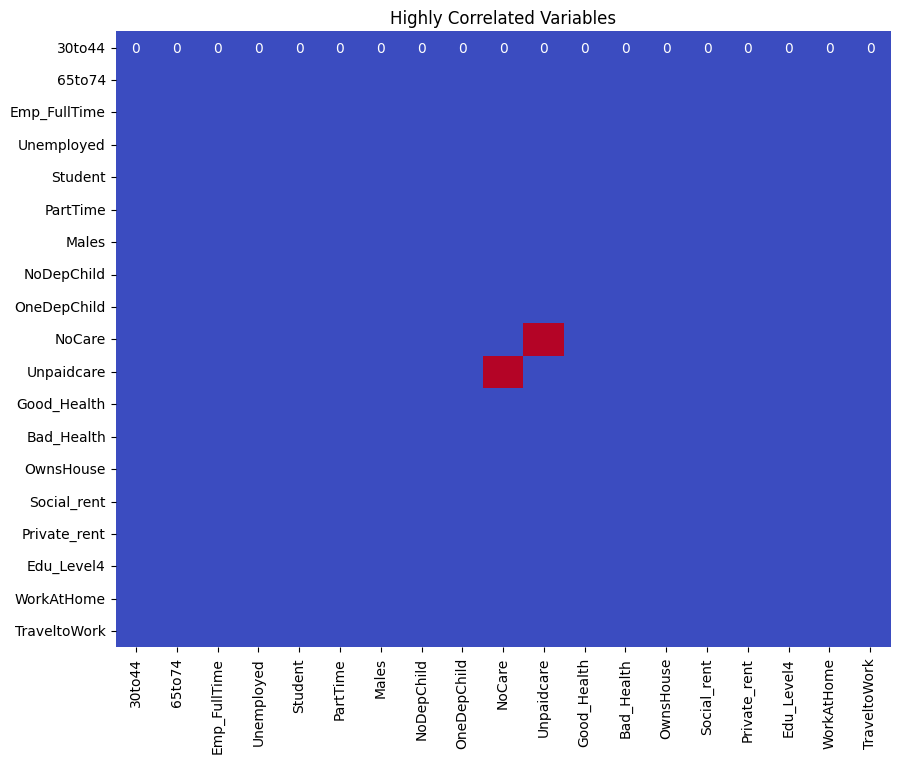

In [25]:
threshold = 0.75 

highly_correlated = (corr.abs() > threshold) & (corr.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated, cmap='coolwarm', cbar=False, annot=True)

plt.title('Highly Correlated Variables')
plt.show()

At a correlation level of 0.8, there were no variables to reduce, so I checked collinearity at a Pearson's coefficient level of 0.75 and there were two variables that were associated with each other. That was 'NoCare' and 'Unpaidcare'. This makes sense, as if you do not do any hours of unpaid care a week, then you are unlikely to do 1-19 hours of unpaid care a week. For this reason, I am going to remove the 'NoCare' variable.

In [26]:
z_score_df.drop(['NoCare'], axis=1, inplace=True)
z_score_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4322 entries, 0 to 4321
Data columns (total 18 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   30to44        4306 non-null   float64
 1   65to74        4095 non-null   float64
 2   Emp_FullTime  4312 non-null   float64
 3   Unemployed    3769 non-null   float64
 4   Student       3829 non-null   float64
 5   PartTime      4305 non-null   float64
 6   Males         4320 non-null   float64
 7   NoDepChild    4321 non-null   float64
 8   OneDepChild   3538 non-null   float64
 9   Unpaidcare    4159 non-null   float64
 10  Good_Health   4320 non-null   float64
 11  Bad_Health    3701 non-null   float64
 12  OwnsHouse     4313 non-null   float64
 13  Social_rent   3035 non-null   float64
 14  Private_rent  4065 non-null   float64
 15  Edu_Level4    4319 non-null   float64
 16  WorkAtHome    4198 non-null   float64
 17  TraveltoWork  4280 non-null   float64
dtypes: float64(18)
memory usage:

Check again:

In [27]:
corr_2 = z_score_df.corr()

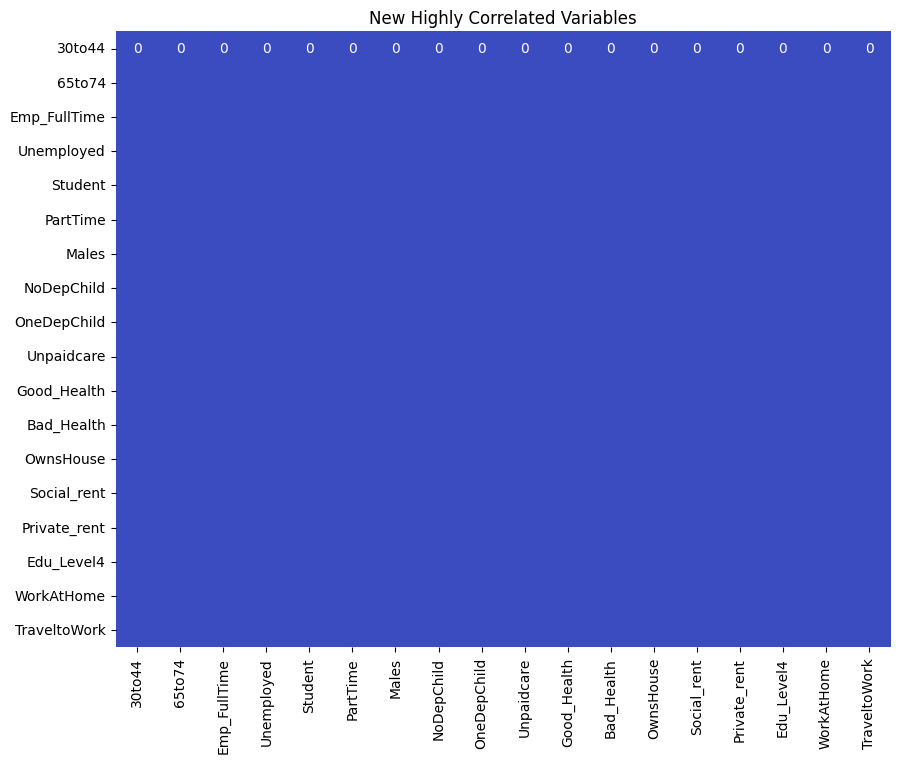

In [28]:
threshold = 0.75
highly_correlated_2 = (corr_2.abs() > threshold) & (corr_2.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated_2, cmap='coolwarm', cbar=False, annot=True)

plt.title('New Highly Correlated Variables')
plt.show()

There are no variables with a correlation above 0.75 pearson's correlation coefficient. So now I am going to check for NaN values and where there are NaN values, I am going to use a process called imputation. I am going to include the mean of the rest of the data as an estimation of each NaN value. 

In [29]:
contains_nan = z_score_df.isna().any().any()

if contains_nan:
    print("The DataFrame contains NaN values.")
else:
    print("The DataFrame does not contain NaN values.")

The DataFrame contains NaN values.


In [30]:
z_score_df.fillna(z_score_df.mean(), inplace=True)

In [31]:
contains_nan = z_score_df.isna().any().any()

if contains_nan:
    print("The DataFrame contains NaN values.")
else:
    print("The DataFrame does not contain NaN values.")

The DataFrame does not contain NaN values.


I have now added all my variables to the dataframe, standardised the results based on population size, standardised the results between different variables, checked and removed collinear variables, checked for NaN values and, where there are NaN values I have included a mean z-score of the DataFrame in place so that I can continue with my analysis. 

The next step will be to use k-means clustering algorithms to create a classification and find an optimal number of groups in each cluster.

7. Utilize the k-means clustering algorithm to create a classification based on the selected variables.
8. Define the optimum number of clusters (i.e., using the Elblow method). Experiment with different values of k.
9. Evaluate your cluster groups (e.g., using PCA) and interpret your cluster centres. Describe your results and repeat the process to adjust the variable selection and cluster groups to provide more meaningful results for your geodemographic goal. Interpret the characteristics of each cluster. What demographic patterns or similarities are prevalent within each group?

I am first going to determine waht is the optimum number of clusters, and then use this value of clusters to create a classification based on the variables.

In [32]:
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist, pdist

The following code is the 'elbow method' and determine what the sum of the squared distances are to teh centroid of each cluster. It is useful to help determine what the optimum number of clusters are. 

A low sum of squared distances indicates that the clusters are more homogenous, however having too many clusters would make it very hard to find differences between the clusters. So a balance is needed between enough clusters to determine differences, but not too many that it is hard to tell where there are differences. 

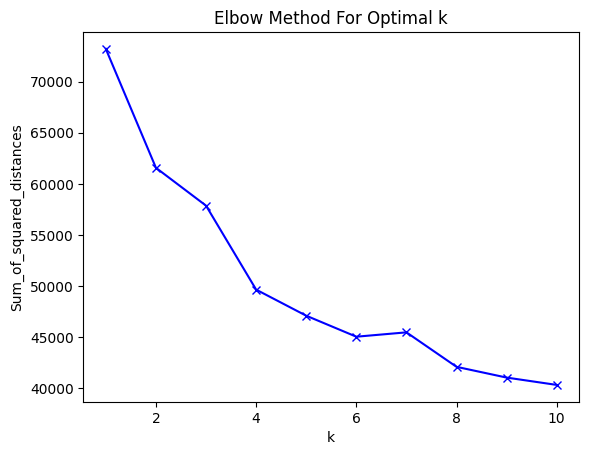

In [33]:
Sum_of_squared_distances = []

K_range = range(1,11)

for k in K_range:
 km = KMeans(n_clusters=k)
 km = km.fit(z_score_df)
 Sum_of_squared_distances.append(km.inertia_)
    
plt.plot(K_range, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this plot, it seems as though there are two bends in the plot, one at around k=3 and one at k=5. Therefore I am going to use a cluster value close to 5. 

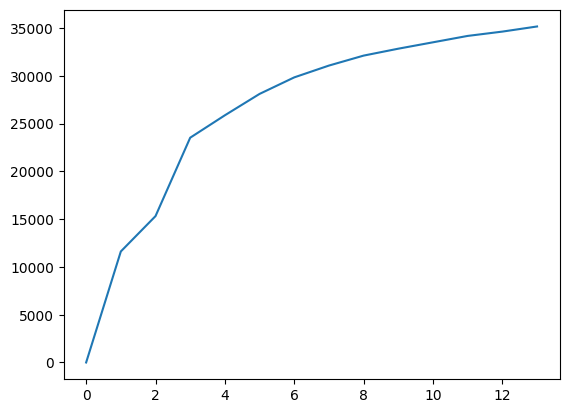

In [34]:
import numpy as np
def elbow(dataframe, n):
    kMeansVar = [KMeans(n_clusters=k).fit(dataframe.values) for k in range(1, n)] #making use of list comprehensions.
    centroids = [X.cluster_centers_ for X in kMeansVar]
    k_euclid = [cdist(dataframe.values, cent) for cent in centroids]
    dist = [np.min(ke, axis=1) for ke in k_euclid]
    wcss = [sum(d**2) for d in dist]
    tss = sum(pdist(dataframe.values)**2)/dataframe.values.shape[0]
    bss = tss - wcss
    plt.plot(bss)
    plt.show()
 
elbow(z_score_df,15)

The previous code is useful as it can provide more information as to how many clusters to use. It shows an bend at around 4 clusters, suggesting that the addition of a 4th cluster does not impact the distinctiveness of the data compared to three clusters. This suggests to use 5 or 6 clusters. I will look at, and evaluate the clusters with 5 and 6 categories to see which is best to use.

To evaluate them, I will first look at the histograms and to see the distributions of each counts of each category. I will then evaluate the clusters graphically using Principal Component Analysis. 

KMeans with 5 clusters:

In [35]:
kmeans = KMeans(n_clusters=5)
kmeans.fit(z_score_df)
labels = kmeans.predict(z_score_df)
cluster_centres = kmeans.cluster_centers_
z_score_df['Cluster'] = kmeans.labels_

In [36]:
z_score_df.head()

,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,Males,NoDepChild,OneDepChild,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork,Cluster
0,-1.082341,0.166806,0.611757,-3.399171e-01,-6.958828e-17,0.491800,0.628442,0.224749,-8.828308e-01,2.286303e-01,-0.479805,6.453347e-01,0.439087,-1.343632e-01,-0.899049,-1.242003,-0.196057,0.463610,4
1,0.195322,-1.236612,0.312919,-2.644813e-01,4.480600e-01,0.383720,-0.496565,2.010205,2.891977e-16,5.899551e-01,-1.212030,2.627071e-01,-0.600661,-6.324441e-01,1.208857,0.943812,-0.462252,-0.867949,3
2,-0.025254,-1.172664,0.011290,1.642727e-02,2.285081e+00,-0.526011,0.488115,1.095940,1.385946e+00,-1.264250e-16,-0.490862,-7.295494e-17,-0.751667,6.204080e-17,1.395779,0.833804,-0.641514,-0.998241,1
3,-0.295765,0.386805,-0.471920,-1.036876e-17,3.082476e-01,0.602516,1.077593,-0.610143,-4.152789e-01,1.483142e+00,-2.178425,-7.140450e-01,-0.321020,-8.284481e-01,0.305400,-0.061980,2.117659,-0.167716,2
4,-0.775216,1.751094,-1.488102,-4.366012e-02,-2.001608e-01,-0.418533,-0.650811,-0.483244,2.891977e-16,8.995157e-01,-1.712077,3.524226e-01,-1.150994,1.647659e+00,-1.011777,0.161530,0.644861,1.977545,2


Checking the histogram to see the distribution of counts in each group:

(array([ 729.,    0.,  434.,    0.,    0., 1008.,    0., 1004.,    0.,
        1147.]),
 array([0. , 0.4, 0.8, 1.2, 1.6, 2. , 2.4, 2.8, 3.2, 3.6, 4. ]),
 <BarContainer object of 10 artists>)

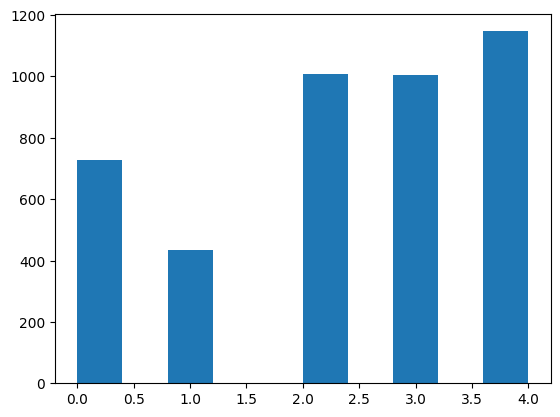

In [37]:
plt.hist(z_score_df['Cluster'])

There are some differences in the sizes of groups, notably the groups 1 and 3 are smaller than the other 3 categories. 

I am now going to run the PCA analysis and determine the variane explained by components in the PCA analysis. The PCA analysis is a method of representing how the different 

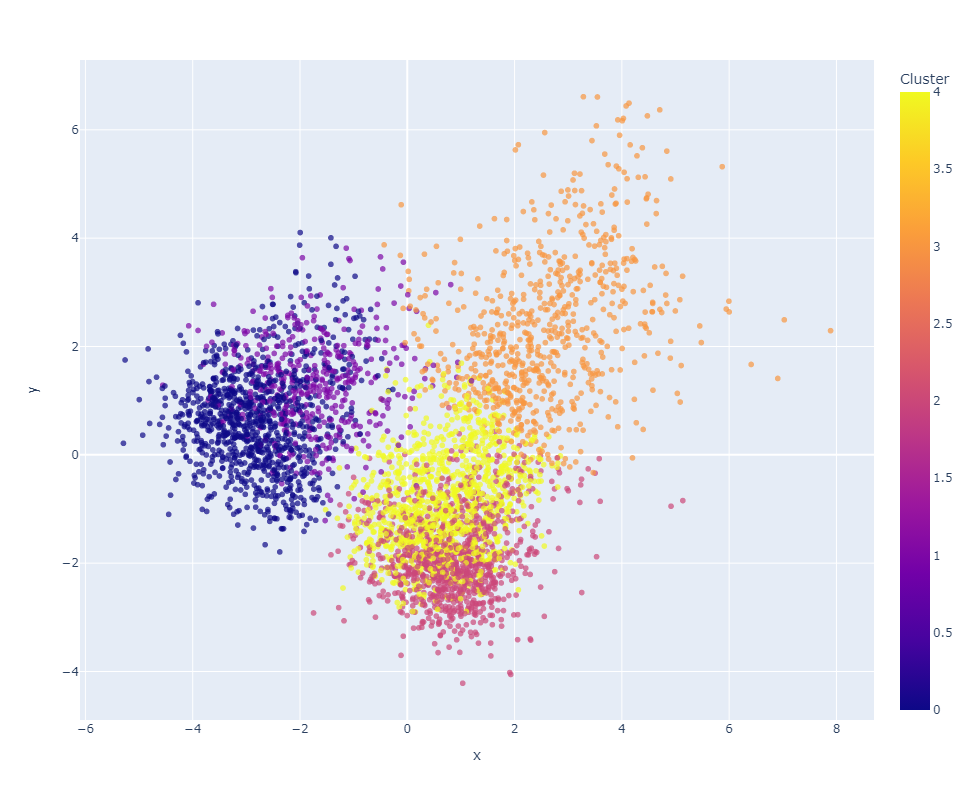

These two components explain 39.39% of the point variability.


<Figure size 1200x800 with 0 Axes>

In [38]:
# Code based on the example provided here: 
# https://scikit-learn.org/stable/auto_examples/decomposition/plot_pca_iris.html#sphx-glr-auto-examples-decomposition-plot-pca-iris-py

import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

plt.figure(figsize=(12, 8))

kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df)

# PCA analysys.
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

# Create a scatter plot
fig = px.scatter(x=pca_result[:, 0], y=pca_result[:, 1], color=clusters,
                 labels={'color': 'Cluster'},
                 #title='Cluster Plot against 1st 2 Principal Components',
                 opacity=0.7,
                 width=800, 
                 height=800)

plt.tight_layout()
fig.show()

print(f"These two components explain {(variance_ratio.sum()*100):.2f}% of the point variability.")

THe plot shows that with 5 different categories, you can see the difference in the different categories well. Whilst there are some overlaps, it is clear that there are 5 different groups and with as many variables as are being used in this analysis, it is likely for there to be some overlap in the cells. 38.85% of the variance in the dataset is explained with this categorisation. Whilst this may seem like not much, there are lots of different variables so it is very hard to capture all of the variance in the data. 

The following code will now show the histogram distrubtion for 6 categories and PCA analysis. This will hopefully help determine how many categories should be used and reduce the bias that is present in geodemographic categorisation 

In [39]:
kmeans = KMeans(n_clusters=6)
kmeans.fit(z_score_df)
labels = kmeans.predict(z_score_df)
cluster_centres = kmeans.cluster_centers_
z_score_df['Cluster'] = kmeans.labels_

In [40]:
z_score_df.head()

,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,Males,NoDepChild,OneDepChild,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork,Cluster
0,-1.082341,0.166806,0.611757,-3.399171e-01,-6.958828e-17,0.491800,0.628442,0.224749,-8.828308e-01,2.286303e-01,-0.479805,6.453347e-01,0.439087,-1.343632e-01,-0.899049,-1.242003,-0.196057,0.463610,1
1,0.195322,-1.236612,0.312919,-2.644813e-01,4.480600e-01,0.383720,-0.496565,2.010205,2.891977e-16,5.899551e-01,-1.212030,2.627071e-01,-0.600661,-6.324441e-01,1.208857,0.943812,-0.462252,-0.867949,2
2,-0.025254,-1.172664,0.011290,1.642727e-02,2.285081e+00,-0.526011,0.488115,1.095940,1.385946e+00,-1.264250e-16,-0.490862,-7.295494e-17,-0.751667,6.204080e-17,1.395779,0.833804,-0.641514,-0.998241,4
3,-0.295765,0.386805,-0.471920,-1.036876e-17,3.082476e-01,0.602516,1.077593,-0.610143,-4.152789e-01,1.483142e+00,-2.178425,-7.140450e-01,-0.321020,-8.284481e-01,0.305400,-0.061980,2.117659,-0.167716,5
4,-0.775216,1.751094,-1.488102,-4.366012e-02,-2.001608e-01,-0.418533,-0.650811,-0.483244,2.891977e-16,8.995157e-01,-1.712077,3.524226e-01,-1.150994,1.647659e+00,-1.011777,0.161530,0.644861,1.977545,0


(array([ 376.,    0., 1121.,    0., 1004.,    0.,  440.,    0.,  434.,
         947.]),
 array([0. , 0.5, 1. , 1.5, 2. , 2.5, 3. , 3.5, 4. , 4.5, 5. ]),
 <BarContainer object of 10 artists>)

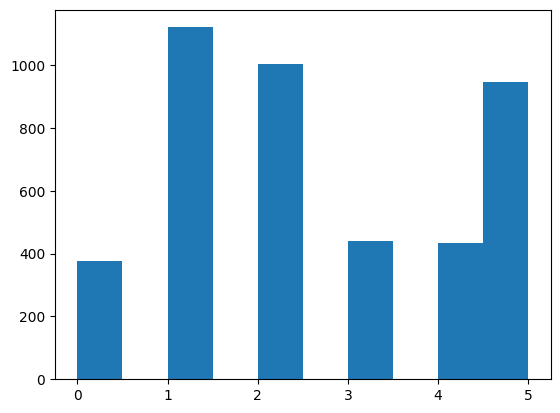

In [41]:
plt.hist(z_score_df['Cluster'])

This histogram also has 2 categories which have a larger number of countrs, and then 4 other categories with a similar number of counts. In my opinion the variation in number of counts per category looks as though it is smaller in using 6 categories than with 5. I will look now at the PCA analysis to see if there is any more variance explained and if the clusters can be seen clearly. 

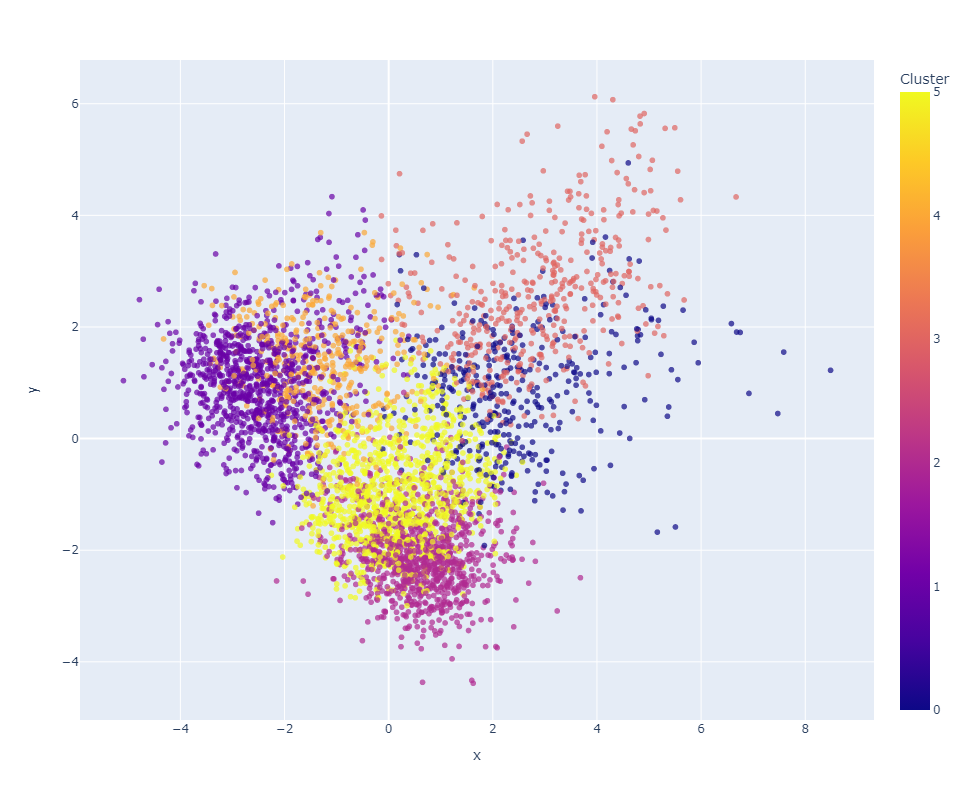

These two components explain 36.94% of the point variability.


<Figure size 1200x800 with 0 Axes>

In [42]:
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

plt.figure(figsize=(12, 8))

kmeans = KMeans(n_clusters=6)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df)

# PCA analysys.
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

# Create a scatter plot
fig = px.scatter(x=pca_result[:, 0], y=pca_result[:, 1], color=clusters,
                 labels={'color': 'Cluster'},
                 #title='Cluster Plot against 1st 2 Principal Components',
                 opacity=0.7,
                 width=800, 
                 height=800)

plt.tight_layout()
fig.show()

print(f"These two components explain {(variance_ratio.sum()*100):.2f}% of the point variability.")

The PCA analysis of 6 groups produces some interesting results. Whilst the histogram may have showed a bit better distribution, it seems to me as though the clusters are far less clear than when I used k=5. Many of the yellow and orange clusters overlap, and the purple and red clusters overlap quite significantly too. This is supported further as 37.36% of the point variability is explained by this PCA, whilst this is only a small decrease. This, combined with the visual clusters suggests that it is better to use k=5 KMeans classification. Even though the distribution of counts in the histograms is slightly worse, the categories seem clearer. 

Doing the KMeans with 5 clusters and adding that to the z_score_df dataframe. 

In [43]:
kmeans = KMeans(n_clusters=5)
kmeans.fit(z_score_df)
labels = kmeans.predict(z_score_df)
cluster_centres = kmeans.cluster_centers_
z_score_df['Cluster'] = kmeans.labels_

In [44]:
z_score_df.head()

,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,Males,NoDepChild,OneDepChild,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork,Cluster
0,-1.082341,0.166806,0.611757,-3.399171e-01,-6.958828e-17,0.491800,0.628442,0.224749,-8.828308e-01,2.286303e-01,-0.479805,6.453347e-01,0.439087,-1.343632e-01,-0.899049,-1.242003,-0.196057,0.463610,0
1,0.195322,-1.236612,0.312919,-2.644813e-01,4.480600e-01,0.383720,-0.496565,2.010205,2.891977e-16,5.899551e-01,-1.212030,2.627071e-01,-0.600661,-6.324441e-01,1.208857,0.943812,-0.462252,-0.867949,1
2,-0.025254,-1.172664,0.011290,1.642727e-02,2.285081e+00,-0.526011,0.488115,1.095940,1.385946e+00,-1.264250e-16,-0.490862,-7.295494e-17,-0.751667,6.204080e-17,1.395779,0.833804,-0.641514,-0.998241,2
3,-0.295765,0.386805,-0.471920,-1.036876e-17,3.082476e-01,0.602516,1.077593,-0.610143,-4.152789e-01,1.483142e+00,-2.178425,-7.140450e-01,-0.321020,-8.284481e-01,0.305400,-0.061980,2.117659,-0.167716,3
4,-0.775216,1.751094,-1.488102,-4.366012e-02,-2.001608e-01,-0.418533,-0.650811,-0.483244,2.891977e-16,8.995157e-01,-1.712077,3.524226e-01,-1.150994,1.647659e+00,-1.011777,0.161530,0.644861,1.977545,3


I am now going to map the cluster centres, this will give me a good indication of the different characteristics that are in each category. Then I can try and define what each category may be. 

In [104]:
# KMeans clustering
kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(z_score_df)

# Get the cluster centers
cluster_centers = kmeans.cluster_centers_

# Get the cluster centers
cluster_centers = pd.DataFrame(kmeans.cluster_centers_, columns=z_score_df.columns)

cluster_centers.head()

,Cluster
0,2.000000e+00
1,-4.662937e-15
2,4.000000e+00
3,3.000000e+00
4,1.000000e+00


The cluster centres show that there are various different clusters, with each cluster having some different characterisitics for each variable. To visualise this better, a radial plot will be made alongside the table so that it can be seen which cluster has which defining characteristics. This will allow me to name them depending on what defining characteristics they have. 

Please note that sometimes the KMeans plots are different with the mean clusters so the cluster means you get when running the code may be different from  what mine were. As a result of this, the screenshots of my radial plots are shown in a markdown cell. To see similar outputs, you may need to change the row selection in each code cluster cell to be associated with the appropriate cluster group. This is due to the way that the KMeans clustering works, as it randomly distributes the seeds of each cluster. So there can be small changes in the mean cluster centre. 

Since the cluster_centers dataframe may change when it is run again, I have saved the dataframe that I made the radial plots from incase you want to load it into the notebook to see if the images are the same as the radial plots provided from the code. However do not run the code cell below. 
If you want to import the cluster_centres use the following code: cluster_centres_check = pd.read_csv("data/radial_centers.csv")

In [97]:
#cluster_centers.to_csv("data/radial_centers.csv", index=False)

The code below will plot a radial plot of the value to mean of each cluster. The red line in the radial plot is at 0, whih indicates this is a mean value of the whole dataframe for this attribute. Therefore any value that is above 0 is above the mean, and any value less than 0 is below the mean. 

The next few cells of code will determine the characteristics of each cluster by producing the radial plot. I have chosen to not try to shorten my code and make a loop that may make the code shorter because I want to be able to evaluate each radial plot as it is made, I also want to be able to associate each plot with the correct cluster group. Right now, the rows are not in the correct order. So I will go through the radial plots in order from cluster 0-4. 

I have removed the last column, clusters, from the radial plot as it was skewing the results of the radial plot, please note that travel to work and aged 30-44 are on the same line, so you may have to refer to the dataset to see which value is which for these variables. 

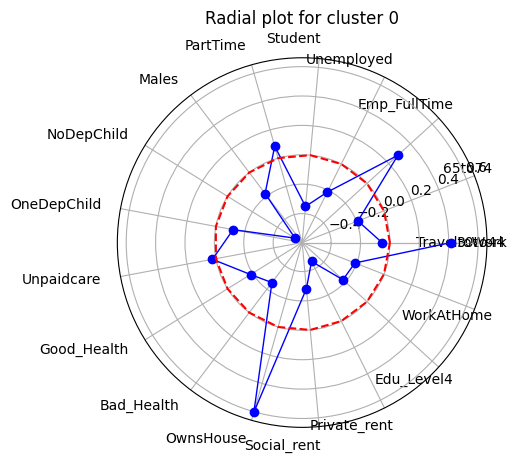

In [96]:
#Cluster group: 0
first_row_centers = cluster_centers.iloc[2, :-1]
# len of features
num_features = len(first_row_centers)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
# Set the title
ax.set_title('Radial plot for cluster 0')

plt.show()

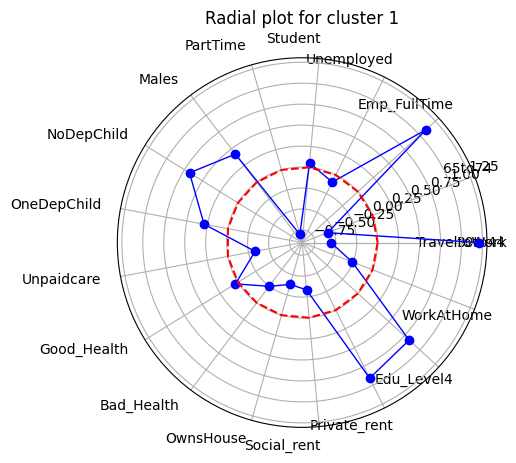

In [69]:
#Cluster group: 1
first_row_centers = cluster_centers.iloc[1, :-1]
# len of features
num_features = len(first_row_centers)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
# Set the title
ax.set_title('Radial plot for cluster 1')

plt.show()

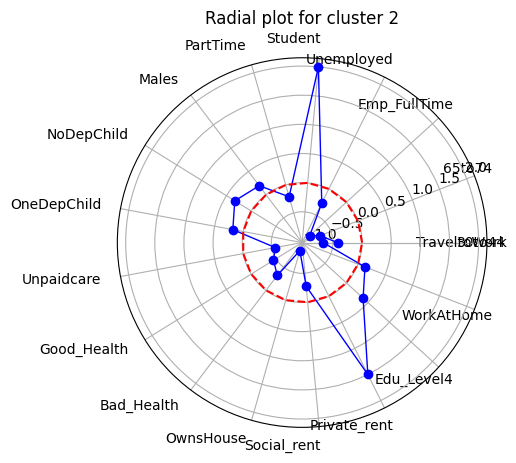

In [68]:
#Cluster group: 2
first_row_centers = cluster_centers.iloc[0, :-1]
# len of features
num_features = len(first_row_centers)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
# Set the title
ax.set_title('Radial plot for cluster 2')

plt.show()

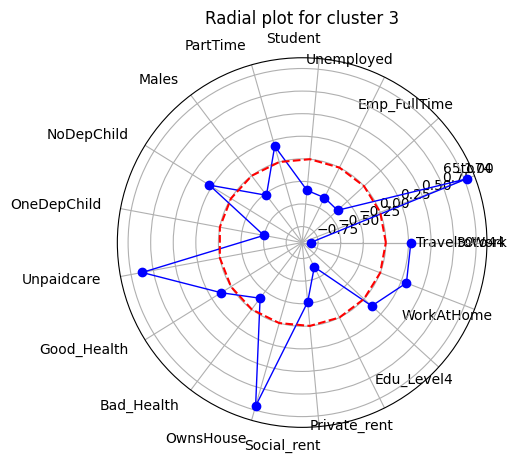

In [67]:
#Cluster group: 3
first_row_centers = cluster_centers.iloc[4, :-1]
# len of features
num_features = len(first_row_centers)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
# Set the title
ax.set_title('Radial plot for cluster 3')

plt.show()

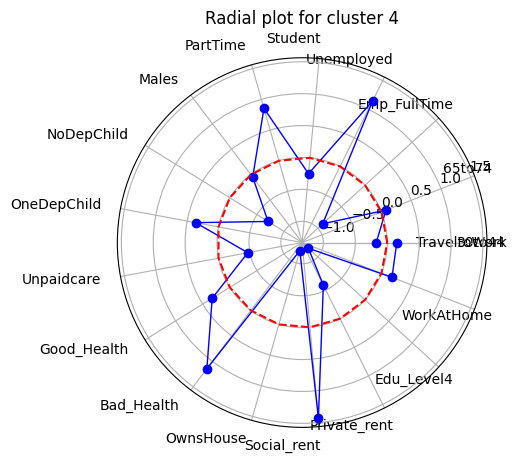

In [66]:
#Cluster group: 4
first_row_centers = cluster_centers.iloc[3, :-1]
# len of features
num_features = len(first_row_centers)

# polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0 value
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
# Set the title
ax.set_title('Radial plot for cluster 4')

plt.show()

There are different characteristics of each radial plot and cluster. From looking at my cluster plots and also checking this with the dataframe I have determined that each cluster has the following characteristics. 

**Cluster 0**
* Neither 30-44 or 65-74
* Do not give unpaid care 
* Below average in 'no dependent children' so it is likely that they have some dependencies 
* They tend to be homeowners
* They travel to work more than work from home
* Almost average level of education when compared to the rest of the population
> Overall, they seem to be quite an average representation of the population, apart from they are definitely homeowners who travel to work and it is likely they have children that they have to look after.


**Cluster 1**
* Lots of people aged 30-44
* Many in full time employment
* Do not tend to have people dependent on them.
* More males
* Average health
* Private renters
* High Education level
> Seems to be younger workers who do not have people dependent on them yet, many are in full time employment and maybe have not settled down with a family yet.

**Cluster 2**
* Students
* Not in the two age categories, I imagine them to be younger than 30
* No people dependent on them
* Average health
* Private renters
* Above average education level
> I imagine this gorup to be younger students, who are renting as they may be at, or just finished university. This is why they have few people dependent on them and the overall education level of the population is still not above average, because they may not have finished thir higher education yet.

**Cluster 3**
* Older population
* No dependent children
* Quite good health
* Homeowners
* Just above average education level
* Provide a lot of unpaid care
> I imagine this group to be the older generation, who seem reasonably comfortable, as they now have no dependent children, are homeowners and in quite good health. They may provide unpaid care to grandchildren or their partners.

**Cluster 4**
* In neither age category
* Many are unemployed
* Lots of people in part time work
* Have dependent children
* Tend to have bad health
* More people are social renters
* They also have a low level of education
> This group seems to be more deprived group, who are looking for employment and doing lots of part time work. They may also be families with dependent children. They are social renters with low education. 

### Mapping the clusters
10. Map the final cluster groups

I am going to map the clusters to see how they look visually, I will then try and rename the clusters depending on their characteristics. 

In [98]:
list(z_score_df.columns)

['30to44',
 '65to74',
 'Emp_FullTime',
 'Unemployed',
 'Student',
 'PartTime',
 'Males',
 'NoDepChild',
 'OneDepChild',
 'Unpaidcare',
 'Good_Health',
 'Bad_Health',
 'OwnsHouse',
 'Social_rent',
 'Private_rent',
 'Edu_Level4',
 'WorkAtHome',
 'TraveltoWork',
 'Cluster']

In [99]:
z_score_df.drop(['30to44',
 '65to74',
 'Emp_FullTime',
 'Unemployed',
 'Student',
 'PartTime',
 'Males',
 'NoDepChild',
 'OneDepChild',
 'Unpaidcare',
 'Good_Health',
 'Bad_Health',
 'OwnsHouse',
 'Social_rent',
 'Private_rent',
 'Edu_Level4',
 'WorkAtHome',
 'TraveltoWork'], axis=1, inplace=True)
z_score_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4322 entries, 0 to 4321
Data columns (total 1 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   Cluster  4322 non-null   int32
dtypes: int32(1)
memory usage: 17.0 KB


In [100]:
# Concatenate the resulting tables.
final_df = pd.concat([edin_census_data, z_score_df], axis=1, ignore_index=False)
final_df.head()

,code,popcount,hhcount,geometry,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,...,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork,Cluster
0,S00106438,151,65,"POLYGON ((312053.000 672642.000, 312066.000 67...",13.245033,8.609272,48.695652,3.478261,NaN,24.096386,...,5.960265,25.827815,5.960265,72.307692,20.000000,6.153846,16.535433,9.638554,28.915663,0
1,S00105168,85,56,"POLYGON ((324246.744 672500.389, 324261.290 67...",24.705882,1.176471,45.000000,3.750000,7.500000,23.214286,...,7.058824,21.176471,4.705882,44.642857,7.142857,46.428571,60.000000,8.000000,12.000000,1
2,S00104758,66,32,"POLYGON ((325970.413 672363.682, 325972.882 67...",22.727273,1.515152,41.269841,4.761905,15.873016,15.789474,...,NaN,25.757576,NaN,40.625000,NaN,50.000000,57.812500,6.896552,10.344828,2
3,S00106865,133,48,"POLYGON ((315157.369 666212.846, 315173.727 66...",20.300752,9.774436,35.294118,NaN,6.862745,25.000000,...,9.774436,15.037594,1.503759,52.083333,2.083333,29.166667,40.000000,23.880597,20.895522,3
4,S00106064,100,50,"POLYGON ((331506.489 673162.694, 331671.000 67...",16.000000,17.000000,22.727273,4.545455,4.545455,16.666667,...,8.000000,18.000000,5.000000,30.000000,66.000000,4.000000,44.444444,14.814815,48.148148,3


In [105]:
final_df.explore(column='Cluster', cmap='Set1', tiles='CartoDB positron')

### Assigning Names to Clusters

11. Finish the analysis by naming the final clusters and plotting a final map that includes the census values and the provided names.


I am now going to assign names to the different categories using help from the ONS pen portraits for 2011 OA classification.

[ONS Pen Portraits](https://webarchive.nationalarchives.gov.uk/ukgwa/20160105160709/http://www.ons.gov.uk/ons/guide-method/geography/products/area-classifications/ns-area-classifications/ns-2011-area-classifications/pen-portraits-and-radial-plots/pen-portraits-oa.pdf).

**Cluster 0 = Comfortable Cosmopolitan**
>This cluster seems associated with family living in houses that are owned. I expect they are a bit older than 44 and have older families.

**Cluster 1 = Urban Professionals**
>This cluster seems to be associated with people who are younger workers maybe in full time employment and have not got a family yet

**Cluster 2 = Inner City Students**
>This cluster seems as though they are Inner City Students, they are more likely to live in private rented accomodation and do not provide care for others. 

**Cluster 3 = Semi-detached ageing**
>Aging city dwellers are an older generation and can be homeowners, the map shows that they tend to live on the outskirts of the city.

**Cluster 4 = Industrious Hardship**
>This cluster seems as though they are more deprived and living in the inner city, they tend to be on social rented housing and have high levels of unemployment

The code below is a function to rename the clusters with the titles that I have assigned to them. There is obviously subjectivity to my interpretation of the groups, alongside the fact that there are many other variables that may have been important in defining these populations. 

In [108]:
final_df.dtypes

code              object
popcount           int64
hhcount            int64
geometry        geometry
30to44           float64
65to74           float64
Emp_FullTime     float64
Unemployed       float64
Student          float64
PartTime         float64
Males            float64
NoDepChild       float64
OneDepChild      float64
NoCare           float64
Unpaidcare       float64
Good_Health      float64
Bad_Health       float64
OwnsHouse        float64
Social_rent      float64
Private_rent     float64
Edu_Level4       float64
WorkAtHome       float64
TraveltoWork     float64
Cluster            int32
dtype: object

I need to change Cluster to a string before renaming the columns 

In [109]:
final_df.Cluster = final_df.Cluster.astype(str)
final_df.dtypes

code              object
popcount           int64
hhcount            int64
geometry        geometry
30to44           float64
65to74           float64
Emp_FullTime     float64
Unemployed       float64
Student          float64
PartTime         float64
Males            float64
NoDepChild       float64
OneDepChild      float64
NoCare           float64
Unpaidcare       float64
Good_Health      float64
Bad_Health       float64
OwnsHouse        float64
Social_rent      float64
Private_rent     float64
Edu_Level4       float64
WorkAtHome       float64
TraveltoWork     float64
Cluster           object
dtype: object

In [110]:
def rename_column(x): 
    x = x.replace("0", "Comforable Cosmopolitan")
    x = x.replace("1", "Urban Professionals")
    x = x.replace("2", "Inner City Students")
    x = x.replace("3", "Semi-detached ageing")
    x = x.replace("4", "Industrious Hardship")
    return x

final_df['Cluster'] = final_df['Cluster'].apply(rename_column)

In [111]:
final_df.head()

,code,popcount,hhcount,geometry,30to44,65to74,Emp_FullTime,Unemployed,Student,PartTime,...,Unpaidcare,Good_Health,Bad_Health,OwnsHouse,Social_rent,Private_rent,Edu_Level4,WorkAtHome,TraveltoWork,Cluster
0,S00106438,151,65,"POLYGON ((312053.000 672642.000, 312066.000 67...",13.245033,8.609272,48.695652,3.478261,NaN,24.096386,...,5.960265,25.827815,5.960265,72.307692,20.000000,6.153846,16.535433,9.638554,28.915663,Comforable Cosmopolitan
1,S00105168,85,56,"POLYGON ((324246.744 672500.389, 324261.290 67...",24.705882,1.176471,45.000000,3.750000,7.500000,23.214286,...,7.058824,21.176471,4.705882,44.642857,7.142857,46.428571,60.000000,8.000000,12.000000,Urban Professionals
2,S00104758,66,32,"POLYGON ((325970.413 672363.682, 325972.882 67...",22.727273,1.515152,41.269841,4.761905,15.873016,15.789474,...,NaN,25.757576,NaN,40.625000,NaN,50.000000,57.812500,6.896552,10.344828,Inner City Students
3,S00106865,133,48,"POLYGON ((315157.369 666212.846, 315173.727 66...",20.300752,9.774436,35.294118,NaN,6.862745,25.000000,...,9.774436,15.037594,1.503759,52.083333,2.083333,29.166667,40.000000,23.880597,20.895522,Semi-detached ageing
4,S00106064,100,50,"POLYGON ((331506.489 673162.694, 331671.000 67...",16.000000,17.000000,22.727273,4.545455,4.545455,16.666667,...,8.000000,18.000000,5.000000,30.000000,66.000000,4.000000,44.444444,14.814815,48.148148,Semi-detached ageing


Printing the final map with labels assigned to the clusters. 

In [112]:
final_df.explore(column='Cluster', cmap='Set1', tiles='CartoDB positron')